## Data Import

dataset URL: https://www.kaggle.com/datasets/imakash3011/customer-personality-analysis

color palette: https://colorhunt.co/palette/0000000b60b040a2d8f0edcf

In [1]:
import warnings
import sys
if not sys.warnoptions:
    warnings.simplefilter("ignore")

In [59]:
!pip install yellowbrick

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 282.6/282.6 kB 4.4 MB/s eta 0:00:00a 0:00:01


In [2]:
import pandas as pd
data = pd.read_csv('/Users/liujingna/Downloads/marketing_campaign.csv', sep='\t')

## Understanding Data

In [3]:
pd.set_option('display.max_columns', None)
data.head(5)

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,5524,1957,Graduation,Single,58138.0,0,0,04-09-2012,58,635,88,546,172,88,88,3,8,10,4,7,0,0,0,0,0,0,3,11,1
1,2174,1954,Graduation,Single,46344.0,1,1,08-03-2014,38,11,1,6,2,1,6,2,1,1,2,5,0,0,0,0,0,0,3,11,0
2,4141,1965,Graduation,Together,71613.0,0,0,21-08-2013,26,426,49,127,111,21,42,1,8,2,10,4,0,0,0,0,0,0,3,11,0
3,6182,1984,Graduation,Together,26646.0,1,0,10-02-2014,26,11,4,20,10,3,5,2,2,0,4,6,0,0,0,0,0,0,3,11,0
4,5324,1981,PhD,Married,58293.0,1,0,19-01-2014,94,173,43,118,46,27,15,5,5,3,6,5,0,0,0,0,0,0,3,11,0


In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2240 entries, 0 to 2239
Data columns (total 29 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   2240 non-null   int64  
 1   Year_Birth           2240 non-null   int64  
 2   Education            2240 non-null   object 
 3   Marital_Status       2240 non-null   object 
 4   Income               2216 non-null   float64
 5   Kidhome              2240 non-null   int64  
 6   Teenhome             2240 non-null   int64  
 7   Dt_Customer          2240 non-null   object 
 8   Recency              2240 non-null   int64  
 9   MntWines             2240 non-null   int64  
 10  MntFruits            2240 non-null   int64  
 11  MntMeatProducts      2240 non-null   int64  
 12  MntFishProducts      2240 non-null   int64  
 13  MntSweetProducts     2240 non-null   int64  
 14  MntGoldProds         2240 non-null   int64  
 15  NumDealsPurchases    2240 non-null   i

In [5]:
data.describe() # numerical data

,ID,Year_Birth,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
count,2240.000000,2240.000000,2216.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.0,2240.0,2240.000000
mean,5592.159821,1968.805804,52247.251354,0.444196,0.506250,49.109375,303.935714,26.302232,166.950000,37.525446,27.062946,44.021875,2.325000,4.084821,2.662054,5.790179,5.316518,0.072768,0.074554,0.072768,0.064286,0.013393,0.009375,3.0,11.0,0.149107
std,3246.662198,11.984069,25173.076661,0.538398,0.544538,28.962453,336.597393,39.773434,225.715373,54.628979,41.280498,52.167439,1.932238,2.778714,2.923101,3.250958,2.426645,0.259813,0.262728,0.259813,0.245316,0.114976,0.096391,0.0,0.0,0.356274
min,0.000000,1893.000000,1730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000
25%,2828.250000,1959.000000,35303.000000,0.000000,0.000000,24.000000,23.750000,1.000000,16.000000,3.000000,1.000000,9.000000,1.000000,2.000000,0.000000,3.000000,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000
50%,5458.500000,1970.000000,51381.500000,0.000000,0.000000,49.000000,173.500000,8.000000,67.000000,12.000000,8.000000,24.000000,2.000000,4.000000,2.000000,5.000000,6.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000
75%,8427.750000,1977.000000,68522.000000,1.000000,1.000000,74.000000,504.250000,33.000000,232.000000,50.000000,33.000000,56.000000,3.000000,6.000000,4.000000,8.000000,7.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000
max,11191.000000,1996.000000,666666.000000,2.000000,2.000000,99.000000,1493.000000,199.000000,1725.000000,259.000000,263.000000,362.000000,15.000000,27.000000,28.000000,13.000000,20.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,3.0,11.0,1.000000


In [6]:
for column in data.select_dtypes(include=['object']).columns:
    print(data[column].value_counts()) # categorical data

Education
Graduation    1127
PhD            486
Master         370
2n Cycle       203
Basic           54
Name: count, dtype: int64
Marital_Status
Married     864
Together    580
Single      480
Divorced    232
Widow        77
Alone         3
Absurd        2
YOLO          2
Name: count, dtype: int64
Dt_Customer
31-08-2012    12
12-09-2012    11
14-02-2013    11
12-05-2014    11
20-08-2013    10
              ..
05-08-2012     1
18-11-2012     1
25-05-2013     1
14-04-2013     1
09-01-2014     1
Name: count, Length: 663, dtype: int64


## Missing Values

In [7]:
missing_values = data.isnull().sum() # Only column income that has 24 missing values
missing_p = round(24/data.shape[0] * 100, 4) # Hard code in 24
print("Missing Values:", missing_values)
print("Missing Value %:", missing_p, "%") # 1.07% of rows have missing values

Missing Values: ID                      0
Year_Birth              0
Education               0
Marital_Status          0
Income                 24
Kidhome                 0
Teenhome                0
Dt_Customer             0
Recency                 0
MntWines                0
MntFruits               0
MntMeatProducts         0
MntFishProducts         0
MntSweetProducts        0
MntGoldProds            0
NumDealsPurchases       0
NumWebPurchases         0
NumCatalogPurchases     0
NumStorePurchases       0
NumWebVisitsMonth       0
AcceptedCmp3            0
AcceptedCmp4            0
AcceptedCmp5            0
AcceptedCmp1            0
AcceptedCmp2            0
Complain                0
Z_CostContact           0
Z_Revenue               0
Response                0
dtype: int64
Missing Value %: 1.0714 %


In [8]:
missing_income_rows = data[data['Income'].isnull()] # Checking the missing row details
missing_income_rows

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
10,1994,1983,Graduation,Married,NaN,1,0,15-11-2013,11,5,5,6,0,2,1,1,1,0,2,7,0,0,0,0,0,0,3,11,0
27,5255,1986,Graduation,Single,NaN,1,0,20-02-2013,19,5,1,3,3,263,362,0,27,0,0,1,0,0,0,0,0,0,3,11,0
43,7281,1959,PhD,Single,NaN,0,0,05-11-2013,80,81,11,50,3,2,39,1,1,3,4,2,0,0,0,0,0,0,3,11,0
48,7244,1951,Graduation,Single,NaN,2,1,01-01-2014,96,48,5,48,6,10,7,3,2,1,4,6,0,0,0,0,0,0,3,11,0
58,8557,1982,Graduation,Single,NaN,1,0,17-06-2013,57,11,3,22,2,2,6,2,2,0,3,6,0,0,0,0,0,0,3,11,0
71,10629,1973,2n Cycle,Married,NaN,1,0,14-09-2012,25,25,3,43,17,4,17,3,3,0,3,8,0,0,0,0,0,0,3,11,0
90,8996,1957,PhD,Married,NaN,2,1,19-11-2012,4,230,42,192,49,37,53,12,7,2,8,9,0,0,0,0,0,0,3,11,0
91,9235,1957,Graduation,Single,NaN,1,1,27-05-2014,45,7,0,8,2,0,1,1,1,0,2,7,0,0,0,0,0,0,3,11,0
92,5798,1973,Master,Together,NaN,0,0,23-11-2013,87,445,37,359,98,28,18,1,2,4,8,1,0,0,0,0,0,0,3,11,0
128,8268,1961,PhD,Married,NaN,0,1,11-07-2013,23,352,0,27,10,0,15,3,6,1,7,6,0,0,0,0,0,0,3,11,0


In [9]:
# Do not want to delete the missing rows, use median income might not be accurate, so using iterative imputer

from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.preprocessing import OneHotEncoder

# separate numerical and categorical values
columns_for_imputation = ['Year_Birth', 'Kidhome', 'Teenhome', 'Income']
data_for_imputation = data[columns_for_imputation].copy()

data_categorical = data[['Education', 'Marital_Status']]
encoder = OneHotEncoder(sparse=False, drop='first')
data_encoded = pd.DataFrame(encoder.fit_transform(data_categorical))
data_encoded.columns = encoder.get_feature_names_out(['Education', 'Marital_Status'])

# combining back the numerical and categorical values
data_for_imputation = pd.concat([data_for_imputation, data_encoded], axis=1)

# impute the missing values
imputer = IterativeImputer()
imputed_data = pd.DataFrame(imputer.fit_transform(data_for_imputation), columns=data_for_imputation.columns)

# use a copy for the new data
data2 = data.copy()
data2.loc[data2['Income'].isnull(), 'Income'] = imputed_data.loc[data2['Income'].isnull(), 'Income']

In [10]:
# Checking whether got rid of missing values
print("Number of missing values for each column:")
print(data2.isnull().sum())

# Checking whether deleted more values than needed
different_rows_data = len(data) - len(pd.merge(data, data2, how='inner'))
different_rows_data2 = len(data2) - len(pd.merge(data, data2, how='inner'))

print("Number of different rows in data compared to data2:", different_rows_data)
print("Number of different rows in data2 compared to data:", different_rows_data2)

Number of missing values for each column:
ID                     0
Year_Birth             0
Education              0
Marital_Status         0
Income                 0
Kidhome                0
Teenhome               0
Dt_Customer            0
Recency                0
MntWines               0
MntFruits              0
MntMeatProducts        0
MntFishProducts        0
MntSweetProducts       0
MntGoldProds           0
NumDealsPurchases      0
NumWebPurchases        0
NumCatalogPurchases    0
NumStorePurchases      0
NumWebVisitsMonth      0
AcceptedCmp3           0
AcceptedCmp4           0
AcceptedCmp5           0
AcceptedCmp1           0
AcceptedCmp2           0
Complain               0
Z_CostContact          0
Z_Revenue              0
Response               0
dtype: int64
Number of different rows in data compared to data2: 24
Number of different rows in data2 compared to data: 24


In [11]:
# double checking whether other data is not imputed
check_value = data2[data2['ID'].isin([5524, 2174, 4141, 1994, 5255, 7281])] # first 3 IDs from the non-missing value row & rest from missing value row
check_value # value matches, go to next phase

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,5524,1957,Graduation,Single,58138.000000,0,0,04-09-2012,58,635,88,546,172,88,88,3,8,10,4,7,0,0,0,0,0,0,3,11,1
1,2174,1954,Graduation,Single,46344.000000,1,1,08-03-2014,38,11,1,6,2,1,6,2,1,1,2,5,0,0,0,0,0,0,3,11,0
2,4141,1965,Graduation,Together,71613.000000,0,0,21-08-2013,26,426,49,127,111,21,42,1,8,2,10,4,0,0,0,0,0,0,3,11,0
10,1994,1983,Graduation,Married,41345.223983,1,0,15-11-2013,11,5,5,6,0,2,1,1,1,0,2,7,0,0,0,0,0,0,3,11,0
27,5255,1986,Graduation,Single,40701.142374,1,0,20-02-2013,19,5,1,3,3,263,362,0,27,0,0,1,0,0,0,0,0,0,3,11,0
43,7281,1959,PhD,Single,65048.006205,0,0,05-11-2013,80,81,11,50,3,2,39,1,1,3,4,2,0,0,0,0,0,0,3,11,0


## Duplication check

In [12]:
data2[data2.duplicated()] # no duplicated values

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response


In [13]:
customer = data2

## Deal with Columns and Modify Data Type

In [14]:
customer.drop(["Z_CostContact" , "Z_Revenue"] ,axis=1, inplace=True)

# Drop "ID" also, they aren't useful. 
customer.drop(["ID"] ,axis=1, inplace=True)

### Remove Customer with age over 100
They're unlikely to make purchase

In [15]:
customer = customer[~customer['Year_Birth'].isin([1893, 1899, 1900])]

In [16]:
customer['Dt_Customer'] = pd.to_datetime(customer['Dt_Customer'], format="%d-%m-%Y")
print('Earliest customer enrollment date: ', customer['Dt_Customer'].min())
print('latiest customer enrollment date: ', customer['Dt_Customer'].max())

Earliest customer enrollment date:  2012-07-30 00:00:00
latiest customer enrollment date:  2014-06-29 00:00:00


**"Customer_For" Column:** number of days customers started to shop in the store relative to the last recorded date

In [17]:
customer["Customer_For"] = (customer["Dt_Customer"].max()  - customer["Dt_Customer"]).dt.days

In [18]:
customer['Education'] = customer['Education'].replace(['PhD', 'Master'],'Postgraduate')  
customer['Education'] = customer['Education'].replace(['Graduation'], 'Undergraduate')
customer['Education'] = customer['Education'].replace(['Basic'], 'Below Undergraduate')
#According to ISCED standard, basic education comprises primary education (first stage of basic education) and lower secondary education (second stage).

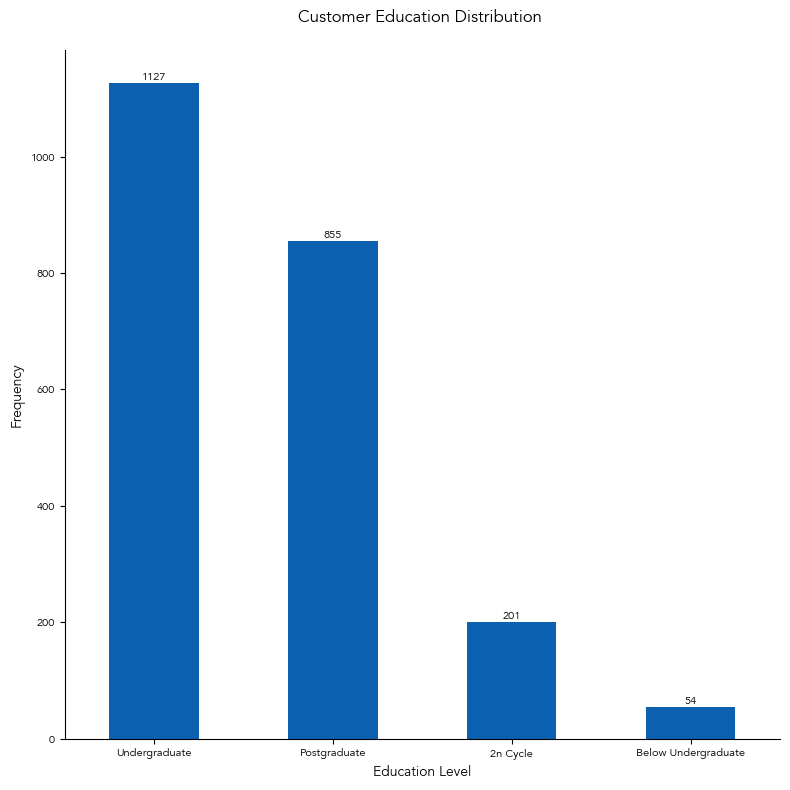

In [19]:
import matplotlib.pyplot as plt
from matplotlib import rcParams

rcParams['font.family'] = 'Avenir'

plt.figure(figsize=(8, 8))
education_counts = customer['Education'].value_counts()
education_counts.plot(kind='bar', color='#0B60B0', linewidth=3)
plt.title("Customer Education Distribution \n", fontsize=12)
plt.xlabel("Education Level", fontsize=10)
plt.ylabel("Frequency", fontsize=10)
plt.xticks(rotation=0, fontsize=8)  # Rotate x-axis labels for better readability
plt.yticks(fontsize=8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

# Adding numbers on top of each bar
for i, value in enumerate(education_counts):
    plt.text(i, value, str(value), ha='center', va='bottom', fontsize=8)

plt.tight_layout()
plt.show()

In [20]:
customer['Marital_Status'] = customer['Marital_Status'].replace(['Married', 'Together'],'In a Relationship')
customer['Marital_Status'] = customer['Marital_Status'].replace(['Divorced', 'Widow', 'Alone', 'YOLO', 'Absurd'],'Single')

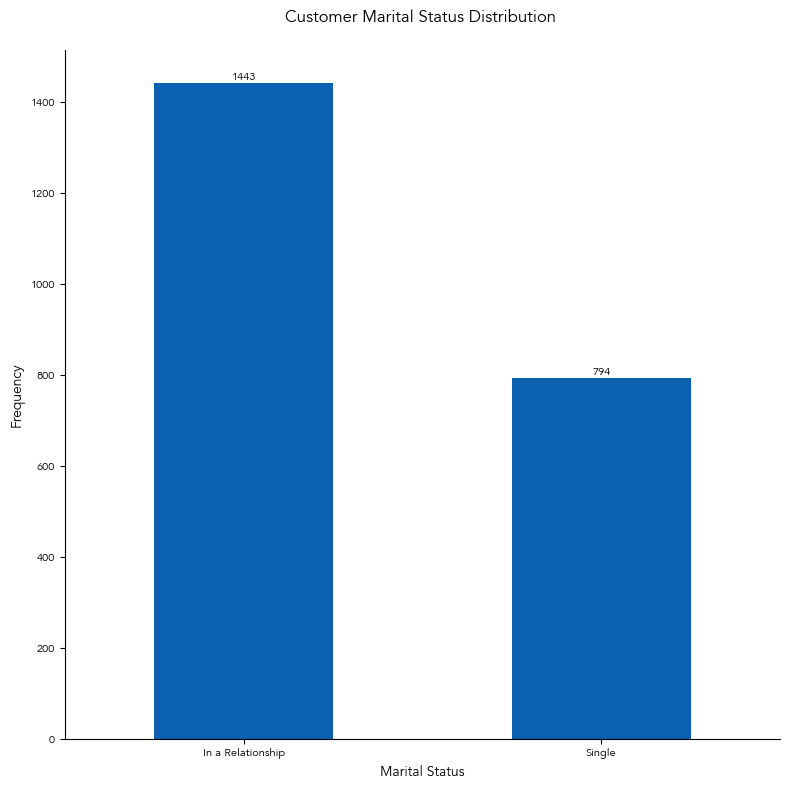

In [21]:
plt.figure(figsize=(8, 8))
marital_status_counts = customer['Marital_Status'].value_counts()
marital_status_counts.plot(kind='bar', color='#0B60B0', linewidth=3)
plt.title("Customer Marital Status Distribution \n", fontsize=12)
plt.xlabel("Marital Status", fontsize=10)
plt.ylabel("Frequency", fontsize=10)
plt.xticks(rotation=0, fontsize=8)  # Rotate x-axis labels for better readability
plt.yticks(fontsize=8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

plt.tight_layout()
# Adding numbers on top of each bar
for i, value in enumerate(marital_status_counts):
    plt.text(i, value, str(value), ha='center', va='bottom', fontsize=8)

# Show the plot
plt.show()

Customers with higher values in `TotalAcceptedCmp` are likely more engaged and receptive to offers.

In [22]:
customer['Kids'] = customer['Kidhome'] + customer['Teenhome']

customer['Expenses'] = customer['MntWines'] + customer['MntFruits'] + customer['MntMeatProducts'] + customer['MntFishProducts'] + customer['MntSweetProducts'] + customer['MntGoldProds']

customer['TotalAcceptedCmp'] = customer['AcceptedCmp1'] + customer['AcceptedCmp2'] + customer['AcceptedCmp3'] + customer['AcceptedCmp4'] + customer['AcceptedCmp5']

customer['NumTotalPurchases'] = customer['NumWebPurchases'] + customer['NumCatalogPurchases'] + customer['NumStorePurchases'] + customer['NumDealsPurchases']

In [23]:
import pandas_profiling

profile = customer.profile_report()
# Display the report
profile.to_notebook_iframe()
profile.to_file("Profiling.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

## Correlation Matrix

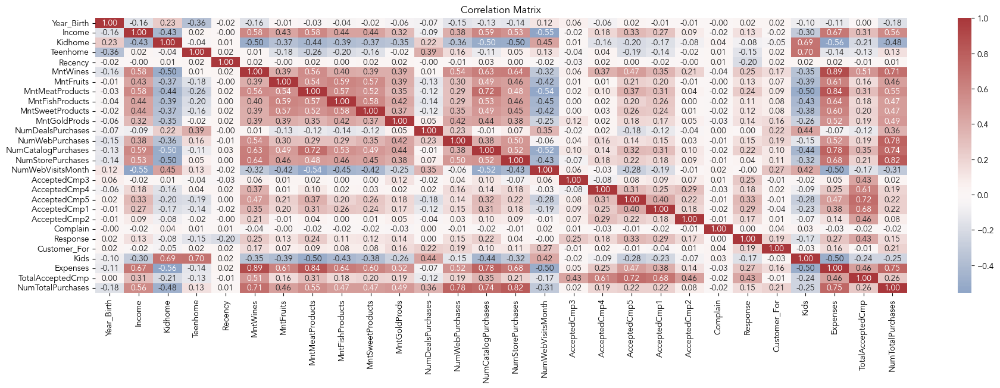

Column pairs with high correlation:
('NumStorePurchases', 'NumTotalPurchases'): 0.82
('Expenses', 'MntWines'): 0.89
('Expenses', 'MntMeatProducts'): 0.84


In [24]:
import seaborn as sns
numerical_columns = customer.select_dtypes(include=['int64', 'float64'])
corr_matrix = numerical_columns.corr()

# Visualize the correlation matrix
plt.figure(figsize=(22, 6))
sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap="vlag", center=0)
plt.title('Correlation Matrix')
plt.show()

# Set the diagonal elements to NaN to ignore self-comparisons
for i in range(len(corr_matrix.columns)):
    corr_matrix.iloc[i, i] = pd.NA

# Find all pairs of columns with high correlation, excluding self-comparison
high_corr_pairs = corr_matrix.unstack().dropna().where(lambda x: (x >= 0.8) | (x <= -0.8))
high_corr_pairs = high_corr_pairs[high_corr_pairs != 1].dropna()  # Exclude exact correlation of 1

# Filter out duplicate pairs
high_corr_pairs = high_corr_pairs[high_corr_pairs.index.get_level_values(0) < high_corr_pairs.index.get_level_values(1)]

if high_corr_pairs.empty:
    print("No high correlation.")
else:
    print("Column pairs with high correlation:")
    for pair, value in high_corr_pairs.items():
        print(f"{pair}: {value:.2f}")

In [25]:
customer = customer.drop(columns=['NumTotalPurchases','Expenses'])

## Outlier Detection

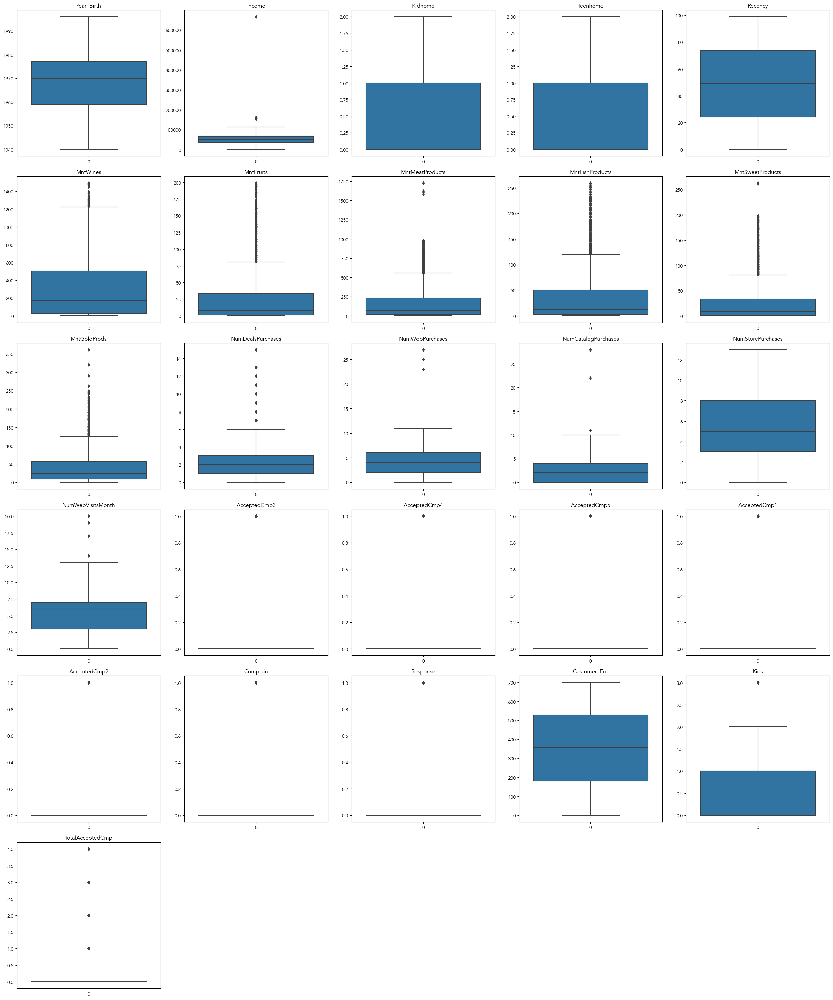

In [26]:
numerical_columns = customer.select_dtypes(include=['int64', 'float64'])
num_cols = len(numerical_columns.columns)
num_rows = (num_cols + 4) // 5

plt.figure(figsize=(25, 5 * num_rows))
for i, column in enumerate(numerical_columns.columns):
    plt.subplot(num_rows, 5, i+1)
    sns.boxplot(data=numerical_columns[column])
    plt.title(column)
plt.tight_layout()
plt.show()

**Notes:** In the box plots for these "Mnt" columns, such as `MntWines`, `MntFruits`, `MntMeatProducts`, `MntFishProducts`, `MntSweetProducts`, and `MntGoldProds`, the presence of many points above the upper whisker indicates that there are customers who spend significantly more than the average customer. These data points are treated as outliers in the statistical sense, but represent high-value customers in our case.

### Do log transformation on Mnt columns

In [27]:
import numpy as np
mnt_columns = [col for col in customer.columns if col.startswith('Mnt')]

# Apply a log transformation to each "Mnt" column, adding 1 to avoid log(0)
for col in mnt_columns:
    customer[f'Log_{col}'] = np.log1p(customer[col])

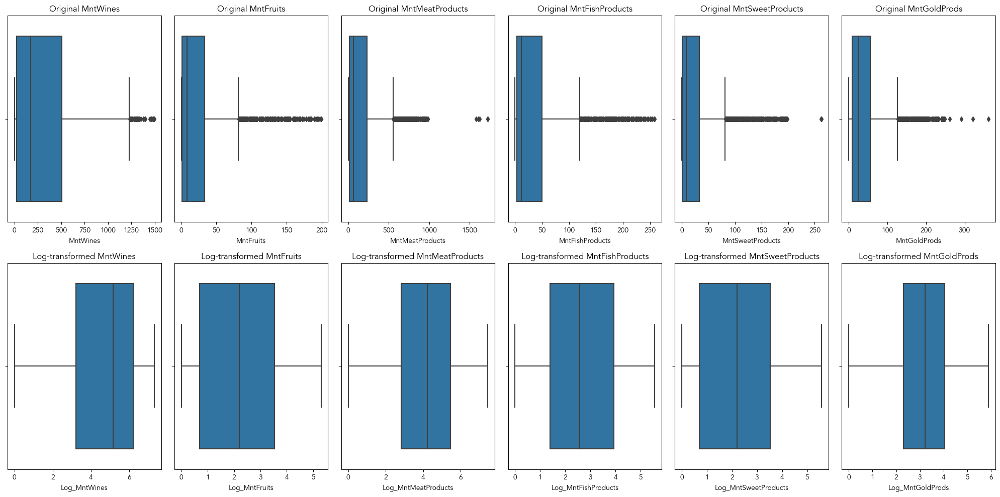

In [28]:
# Plot the boxplots for the original and log-transformed 'Mnt' columns side by side for comparison.
fig, axes = plt.subplots(nrows=2, ncols=len(mnt_columns), figsize=(20, 10))

for i, col in enumerate(mnt_columns):
    sns.boxplot(data=customer, x=col, ax=axes[0, i]).set_title(f'Original {col}')
    sns.boxplot(data=customer, x=f'Log_{col}', ax=axes[1, i]).set_title(f'Log-transformed {col}')

plt.tight_layout()
plt.show()

## Feature Engineer

In [29]:
customer.columns

Index(['Year_Birth', 'Education', 'Marital_Status', 'Income', 'Kidhome',
       'Teenhome', 'Dt_Customer', 'Recency', 'MntWines', 'MntFruits',
       'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1',
       'AcceptedCmp2', 'Complain', 'Response', 'Customer_For', 'Kids',
       'TotalAcceptedCmp', 'Log_MntWines', 'Log_MntFruits',
       'Log_MntMeatProducts', 'Log_MntFishProducts', 'Log_MntSweetProducts',
       'Log_MntGoldProds'],
      dtype='object')

In [48]:
df = customer.copy()
df = df[['Year_Birth', 'Education', 'Marital_Status', 'Income', 'Dt_Customer', 'Customer_For', 'Recency', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth','Complain', 'Response', 'Kids','TotalAcceptedCmp', 'Log_MntWines',
       'Log_MntFruits', 'Log_MntMeatProducts', 'Log_MntFishProducts','Log_MntSweetProducts', 'Log_MntGoldProds']]

In [49]:
from sklearn.preprocessing import OneHotEncoder

encoder = OneHotEncoder(drop='first', sparse=False)

# Fit and transform the data, converting the result back to a DataFrame
encoded_data = encoder.fit_transform(df[['Education', 'Marital_Status']])
encoded_feature_names = encoder.get_feature_names_out(['Education', 'Marital_Status'])
encoded_df = pd.DataFrame(encoded_data, columns=encoded_feature_names, index=df.index)  # Ensure matching index

# Concatenate the original DataFrame (minus the encoded columns) with the new encoded DataFrame
df_final = pd.concat([df.drop(columns=['Education', 'Marital_Status']), encoded_df], axis=1)

### Run Different Feature Selection Algorithms

                          feature      vimp
11               TotalAcceptedCmp  0.088388
14            Log_MntMeatProducts  0.046822
1                          Income  0.039564
12                   Log_MntWines  0.037039
17               Log_MntGoldProds  0.034603
3                         Recency  0.029784
6             NumCatalogPurchases  0.029607
2                    Customer_For  0.024421
21          Marital_Status_Single  0.021527
5                 NumWebPurchases  0.019298
7               NumStorePurchases  0.016080
13                  Log_MntFruits  0.016019
15            Log_MntFishProducts  0.013295
10                           Kids  0.012312
4               NumDealsPurchases  0.005746
16           Log_MntSweetProducts  0.005595
0                      Year_Birth  0.004088
9                        Complain  0.003322
18  Education_Below Undergraduate  0.001955
8               NumWebVisitsMonth  0.000000
19         Education_Postgraduate  0.000000
20        Education_Undergraduat

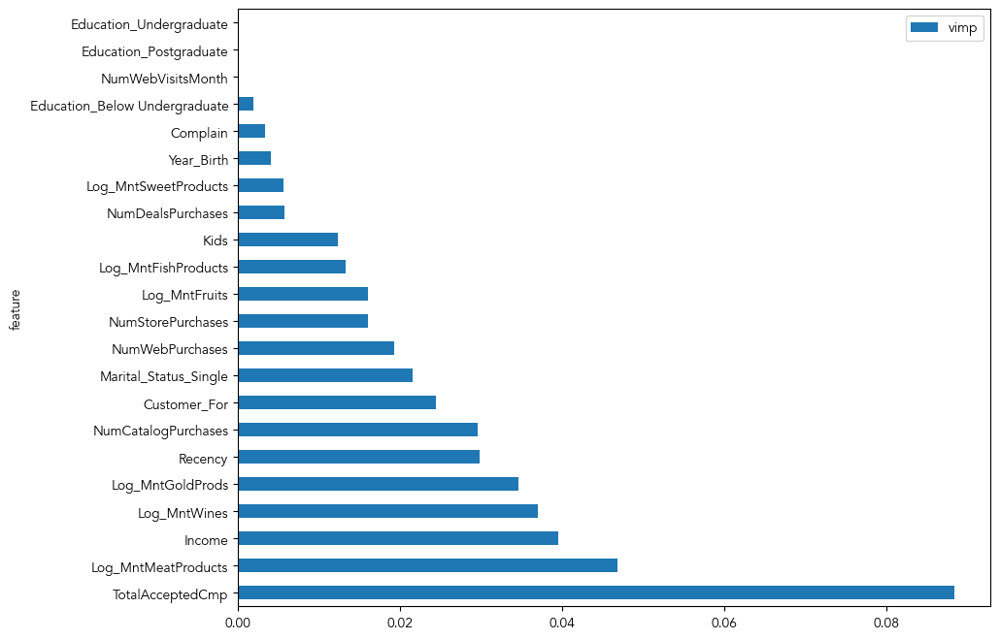

In [57]:
from sklearn import feature_selection

X = df_final.drop(columns=['Response', 'Dt_Customer'])
y = df_final['Response']

mic = feature_selection.mutual_info_classif(X, y)

# Create a DataFrame with features and their importance scores
feature_importances = pd.DataFrame({"feature": X.columns, "vimp": mic})

# Sort the features by their importance scores in descending order
top_features = feature_importances.sort_values(by="vimp", ascending=False)

print(top_features)
# Plotting the feature importances (for all features, not just the top 15)
fig, ax = plt.subplots(figsize=(10, 8))
top_features.set_index("feature").plot.barh(ax=ax)
plt.show()

**Features Selected(based on vimp>0.02):** `TotalAcceptedCmp`, `Log_MntMeatProducts`, `Income`, `Log_MntWines`, `Log_MntGoldProds`,`Recency`, `NumCatalogPurchases`, `Customer_For`, `Marital_Status_Single`

In [55]:
from sklearn import ensemble
from sklearn.feature_selection import RFE
model = ensemble.RandomForestClassifier(n_estimators=100)
rfe = RFE(model)
rfe.fit(X, y)
X.columns[rfe.support_]

Index(['Year_Birth', 'Income', 'Customer_For', 'Recency', 'NumStorePurchases',
       'TotalAcceptedCmp', 'Log_MntWines', 'Log_MntMeatProducts',
       'Log_MntFishProducts', 'Log_MntSweetProducts', 'Log_MntGoldProds'],
      dtype='object')

**Features Selected(based on RFE):** `Year_Birth`, `Income`, `Customer_For`, `Recency`, `NumStorePurchases`, `TotalAcceptedCmp`, `Log_MntWines`, `Log_MntMeatProducts`, `Log_MntFishProducts`, `Log_MntSweetProducts`, `Log_MntGoldProds`

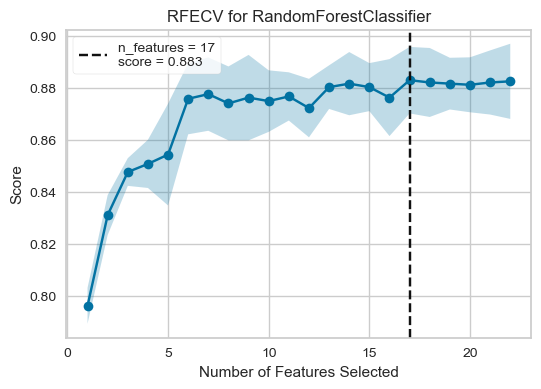

<Axes: title={'center': 'RFECV for RandomForestClassifier'}, xlabel='Number of Features Selected', ylabel='Score'>

In [60]:
import matplotlib.pyplot as plt
from sklearn import ensemble
from yellowbrick.features import RFECV

fig, ax = plt.subplots(figsize=(6, 4))
rfe = RFECV(ensemble.RandomForestClassifier(n_estimators=100),cv=5,)
rfe.fit(X, y)
rfe.rfe_estimator_.ranking_
rfe.rfe_estimator_.n_features_
rfe.rfe_estimator_.support_
rfe.poof()

In [62]:
ranking = rfe.rfe_estimator_.ranking_
feature_ranking = pd.DataFrame({'Feature': X.columns, 'Ranking': ranking})
sorted_features = feature_ranking.sort_values('Ranking')

# Select the top 6 features based on graph
top_6_features = sorted_features.head(6)
print(top_6_features['Feature'])

0               Year_Birth
17        Log_MntGoldProds
16    Log_MntSweetProducts
15     Log_MntFishProducts
14     Log_MntMeatProducts
13           Log_MntFruits
Name: Feature, dtype: object


**Features Selected(based on RFE):** `Year_Birth`, `Log_MntGoldProds`, `Log_MntSweetProducts`, `Log_MntFishProducts`,`Log_MntMeatProducts`, `Log_MntFruits`

#### PCA

[Text(0.5, 0, 'Component'),
 Text(0, 0.5, 'Percent of Explained variance'),
 Text(0.5, 1.0, 'Cumulative Variance'),
 (0.0, 1.0)]

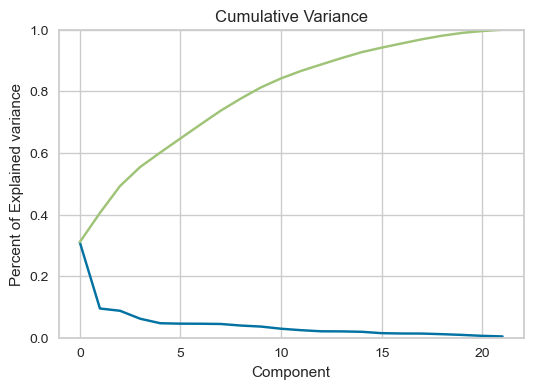

In [70]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import (StandardScaler,)

pca = PCA(random_state=42)
X_pca = pca.fit_transform(StandardScaler().fit_transform(X))
pca.explained_variance_ratio_
pca.components_[0]

fig, ax = plt.subplots(figsize=(6, 4))
ax.plot(pca.explained_variance_ratio_)
ax.set(
    xlabel="Component",
    ylabel="Percent of Explained variance",
    title="Scree Plot",
    ylim=(0, 1),)

ax.plot(np.cumsum(pca.explained_variance_ratio_))
ax.set(
    xlabel="Component",
    ylabel="Percent of Explained variance",
    title="Cumulative Variance",
    ylim=(0, 1),)

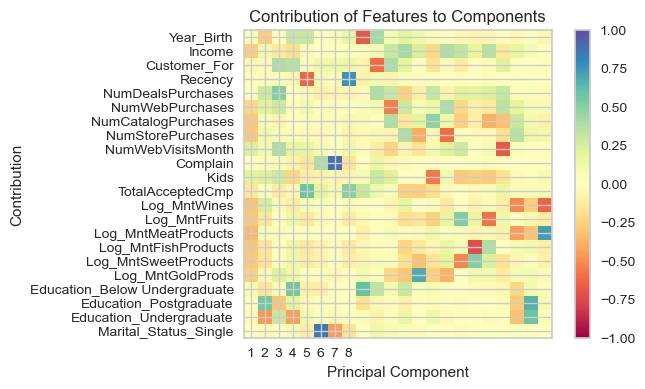

In [68]:
fig, ax = plt.subplots(figsize=(6, 4))
plt.imshow(
    pca.components_.T,
    cmap="Spectral",
    vmin=-1,
    vmax=1,)
plt.yticks(range(len(X.columns)), X.columns)
plt.xticks(range(8), range(1, 9))
plt.xlabel("Principal Component")
plt.ylabel("Contribution")
plt.title("Contribution of Features to Components")
plt.colorbar()

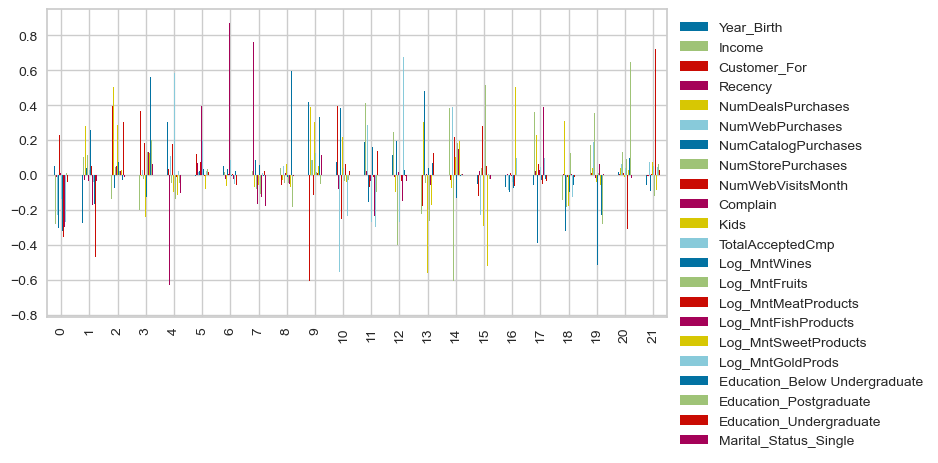

In [71]:
fig, ax = plt.subplots(figsize=(8, 4))
pd.DataFrame(pca.components_, columns=X.columns).plot(kind="bar", ax=ax).legend(bbox_to_anchor=(1, 1))

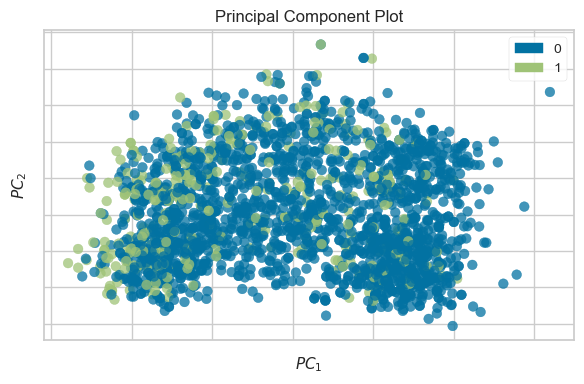

<Axes: title={'center': 'Principal Component Plot'}, xlabel='$PC_1$', ylabel='$PC_2$'>

In [72]:
from yellowbrick.features.pca import (PCADecomposition,)
fig, ax = plt.subplots(figsize=(6, 4))
colors = ["rg"[j] for j in y]
pca_viz = PCADecomposition(color=colors)
pca_viz.fit_transform(X, y)
pca_viz.poof()